In [55]:
from pytrends.request import TrendReq
import json
import requests
import datetime as dt
import tweepy

# Google Trends

In [114]:
pytrend = TrendReq()
pytrend.trending_searches()

,0
0,Google Docs
1,iOS 16 release date
2,Drive
3,Elias Theodorou
4,Bills
5,Antonio Brown
6,Dallas Cowboys
7,NFL
8,NFL scores
9,Packers


In [132]:
query = 'Queen Elizabeth'
pytrend = TrendReq()
pytrend.build_payload(kw_list=[query])
trending = pytrend.trending_searches()

In [133]:
for item in trending.iteritems():
    print(item[1][0])

Armenia


In [134]:
for trend in trending.iterrows():
    print(trend[1][0])

Armenia
PnB Rock
Emmys 2022
Google Docs
Google Maps
iOS 16
Maps
LinkedIn
Outlook
Zoom
Zendaya
Dow Jones
Dopesick
Fidelity
Elias Theodorou
Queen Elizabeth children
Drive
Abbott Elementary
Social Security
Britney Spears


In [152]:
# Historical Interest
query = 'Citizen Kane'
pytrend = TrendReq()
pytrend.build_payload(kw_list=[query])

historical = pytrend.interest_over_time()[query]
historical

date
2017-09-17    24
2017-09-24    23
2017-10-01    26
2017-10-08    24
2017-10-15    26
              ..
2022-08-07    19
2022-08-14    17
2022-08-21    17
2022-08-28    18
2022-09-04    15
Name: Citizen Kane, Length: 260, dtype: int64

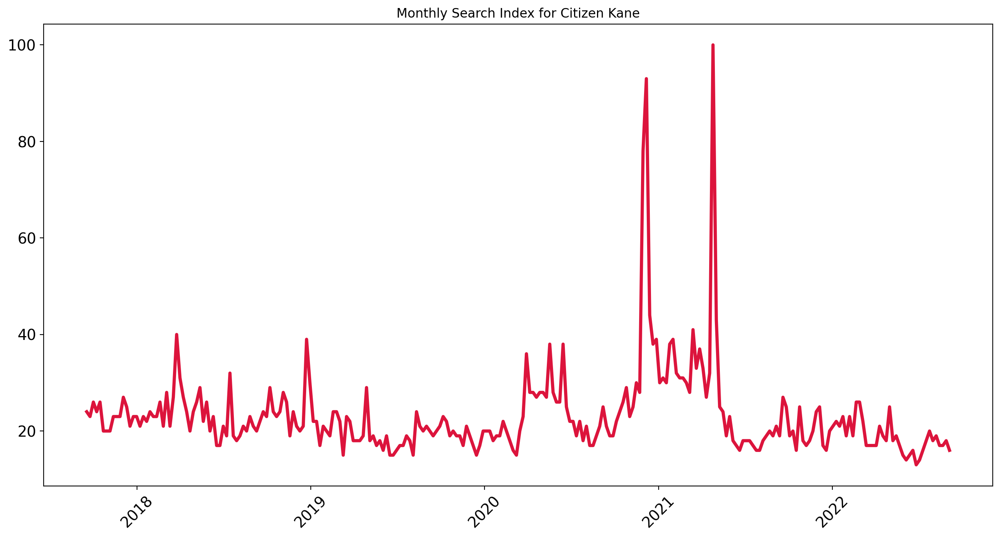

In [149]:
import pandas as pd
import numpy as np
import plotly.express as px
import seaborn as sns
import matplotlib.pyplot as plt

plt.figure(figsize=(16,8), dpi=200)
plt.title(f'Monthly Search Index for {query}')
plt.yticks(fontsize=14)
plt.xticks(fontsize=14, rotation=45)
plt.plot(historical.index, historical.values, c='crimson', linewidth=3)
plt.savefig('static/img/historical.jpg')

In [154]:
# Interest by Region
regions = pytrend.interest_by_region()
regions = regions.sort_values(by=query, ascending=False)
regions = regions[0:10]
regions

,Citizen Kane
geoName,
United States,100
Belgium,96
Ireland,92
Canada,89
Sweden,88
United Kingdom,79
Australia,71
New Zealand,63
Denmark,62


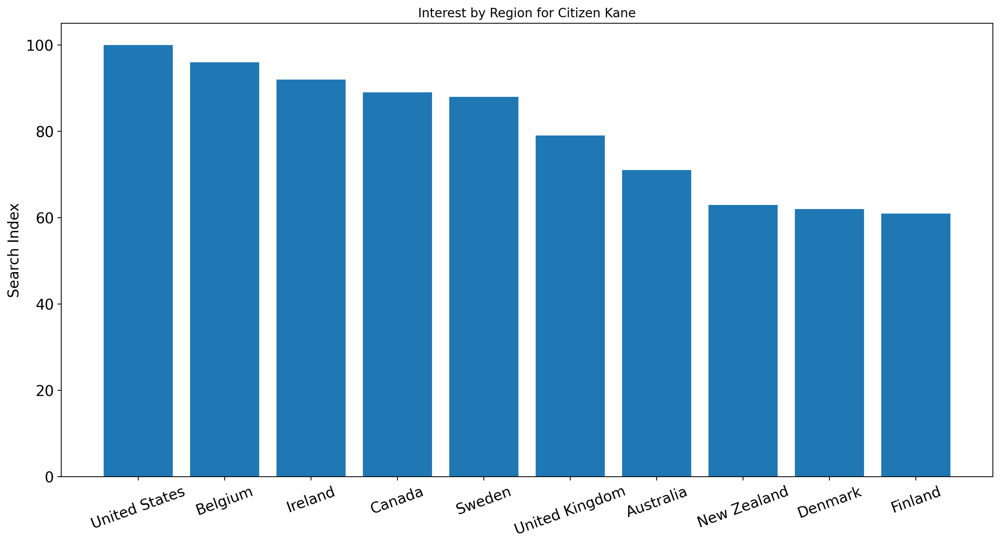

In [157]:
plt.figure(figsize=(16,8), dpi=200)
plt.xticks(fontsize=14, rotation=20)
plt.yticks(fontsize=14)
plt.title(f'Interest by Region for {query}')
plt.ylabel('Search Index', fontsize=14)

plt.bar(regions.index, regions[query])
plt.savefig('static/img/regions.jpg')

In [50]:
# Related Queries
related = pytrend.related_queries()
related = related[query]['top']
related

,query,value
0,the queen elizabeth,100
1,the queen,100
2,queen elizabeth nail polish,62
3,elizabeth ii,57
4,queen elizabeth ii,57
5,queen elizabeth age,27
6,how old is queen elizabeth,25
7,queen elizabeth nail color,24
8,queen elizabeth nail polish color,22
9,queen elizabeth hospital,21


# News API

In [73]:
# Read in credential string and save as a dictionary
with open('../../../../Dropbox/100DaysOfCodePRIVATE/Day95Creds.json') as file:
    creds = json.loads(file.read())

NEWS_ENDPOINT = "https://newsapi.org/v2/everything"
NEWS_KEY = creds['NEWS_API']

# STEP 2: Fetch top three articles that mention the query
# Use https://newsapi.org/docs/endpoints/everything

today = dt.datetime.today().strftime('%Y-%m-%d')
news_url = f'{NEWS_ENDPOINT}?q={query.lower()}&from={today}&sortBy=publishedAt&apiKey={NEWS_KEY}&language=en'
response = requests.get(news_url)

In [58]:
# Print status, return data
print('News response status code:', response.status_code)
response.raise_for_status()
news_data = response.json()
news = news_data['articles']

# Save select info from top three articles
top_three_articles = ''
for i in range(0, 3):
    article = news[i]
    top_three_articles += f'Title: {article["title"]}\nURL: {article["url"]}\nBrief:{article["description"]}\n\n'
print(top_three_articles)

News response status code: 200
Title: Why Princess Anne is walking behind Queen's coffin - but other female royals are in car
URL: https://www.mirror.co.uk/news/royals/princess-anne-walking-behind-queens-27969375
Brief:The Queen's children, King Charles, Princess Anne, Prince Andrew and Prince Edward, walked in a line behind their mother's coffin as it is taken from the Palace of Holyroodhouse to the nearby St Giles' Cathedral in Edinburgh.

Title: Primark to close all shops for Queen's funeral on Monday as Bank Holiday announced
URL: https://www.mirror.co.uk/news/royals/primark-close-shops-queens-funeral-27971403
Brief:The retailer's 191 stores will remain closed on September to give colleagues a chance to pay their respects to the late monarch. The shops will open the following day, on September 20

Title: The latest university to mishandle a faculty speech controversy: CMU and the case of Professor Anya
URL: https://leiterreports.typepad.com/blog/2022/09/the-latest-university-to-mis

# Twitter API

In [74]:
# API keys that yous saved earlier
api_key = creds['TWITTER_KEY']
api_secrets = creds['TWITTER_SECRET']
access_token = creds['ACCESS_TOKEN']
access_secret = creds['ACCESS_SECRET']

# Authenticate to Twitter
auth = tweepy.OAuthHandler(api_key,api_secrets)
auth.set_access_token(access_token,access_secret)

api = tweepy.API(auth)

try:
    api.verify_credentials()
    print('Successful Authentication')
except:
    print('Failed authentication')

Successful Authentication


In [78]:
query = 'python'
max_tweets = 20
searched_tweets = [status for status in tweepy.Cursor(api.search_tweets, q=query).items(max_tweets)]
searched_tweets

[Status(_api=<tweepy.api.API object at 0x7fd3df87abe0>, _json={'created_at': 'Mon Sep 12 15:16:11 +0000 2022', 'id': 1569344127614984192, 'id_str': '1569344127614984192', 'text': 'RT @ingliguori: #Infographic: #SQL Query Execution Order \nVia @ingliguori\n#ArtificialIntelligence #AI #ML #MachineLearning #DataScientists…', 'truncated': False, 'entities': {'hashtags': [{'text': 'Infographic', 'indices': [16, 28]}, {'text': 'SQL', 'indices': [30, 34]}, {'text': 'ArtificialIntelligence', 'indices': [74, 97]}, {'text': 'AI', 'indices': [98, 101]}, {'text': 'ML', 'indices': [102, 105]}, {'text': 'MachineLearning', 'indices': [106, 122]}, {'text': 'DataScientists', 'indices': [123, 138]}], 'symbols': [], 'user_mentions': [{'screen_name': 'ingliguori', 'name': 'Giuliano Liguori', 'id': 836510570, 'id_str': '836510570', 'indices': [3, 14]}, {'screen_name': 'ingliguori', 'name': 'Giuliano Liguori', 'id': 836510570, 'id_str': '836510570', 'indices': [62, 73]}], 'urls': []}, 'metadata': {'iso_lang

In [89]:
i = 0
t = searched_tweets[i]._json
t

{'created_at': 'Mon Sep 12 15:16:11 +0000 2022',
 'id': 1569344127614984192,
 'id_str': '1569344127614984192',
 'text': 'RT @ingliguori: #Infographic: #SQL Query Execution Order \nVia @ingliguori\n#ArtificialIntelligence #AI #ML #MachineLearning #DataScientists…',
 'truncated': False,
 'entities': {'hashtags': [{'text': 'Infographic', 'indices': [16, 28]},
   {'text': 'SQL', 'indices': [30, 34]},
   {'text': 'ArtificialIntelligence', 'indices': [74, 97]},
   {'text': 'AI', 'indices': [98, 101]},
   {'text': 'ML', 'indices': [102, 105]},
   {'text': 'MachineLearning', 'indices': [106, 122]},
   {'text': 'DataScientists', 'indices': [123, 138]}],
  'symbols': [],
  'user_mentions': [{'screen_name': 'ingliguori',
    'name': 'Giuliano Liguori',
    'id': 836510570,
    'id_str': '836510570',
    'indices': [3, 14]},
   {'screen_name': 'ingliguori',
    'name': 'Giuliano Liguori',
    'id': 836510570,
    'id_str': '836510570',
    'indices': [62, 73]}],
  'urls': []},
 'metadata': {'iso_l

In [101]:
t['text']
t['created_at']
t['user']['screen_name']
t['user']['name']
t['user']['location']
f"https://twitter.com/{t['user']['screen_name']}/status/{t['id_str']}"

'https://twitter.com/vindhizo/status/1569344127614984192'